# Exploration of Projection Spaces

In [1]:
# Feel free to add dependencies, but make sure that they are included in environment.yml

#disable some annoying warnings
import warnings
warnings.filterwarnings('ignore', category=FutureWarning)
warnings.filterwarnings('ignore', category=UserWarning)

# import builtins
import random
import os

from copy import copy
from itertools import product, chain

#plots the figures in place instead of a new window
%matplotlib inline

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import altair as alt
from altair import datum
alt.data_transformers.disable_max_rows()

import sklearn
from sklearn import manifold
from openTSNE import TSNE
from umap import UMAP

## Data
To be able to explore paths in a projected space, you need to pick a problem/algorithm/model that consists of multiple states that change iteratively.

<details>
    <summary><a>Click to see an Example</a></summary>

    
An example would is the solving of a Rubik's Cube. After each rotation the state of the cube changes. This results in a path from the initial state, through the individual rotations, to the solved cube.
By using projection we can examine the individual states and paths in the two-dimensional space.
Depending on the initial state and the solution strategy the paths will differ or resemble each other.
    
This is an example of solving 10 randomly scrambled Rubik's Cubes with two different strategies, the Beginner (in green) and the Fridrich Method (in orange):
<div>
    <img alt="Rubiks's Cube Sovling Strategies" src="rubiks.png" width="600"/>
</div>
You can see that although each cube is scrambled differently in the beginning, both strategies converge to the same paths after a few steps.
You can also notice that the Beginner's method takes some additional paths that are not necessary with the Fridrich method.
</details>

### Read and Prepare Data
Read in your data from a file or create your own data.

Document any data processing steps.

In [2]:
FIELD_SIZE = 4  # you can change this to 3, the data for it is already cached.
BIN_CNT = FIELD_SIZE*(FIELD_SIZE-1)
BINS = [0] + [2**i for i in range(1, BIN_CNT)]
BIN_ = ['cnt' + str(i) for i in BINS]
FIELD_ = ['a' + str(i) for i in range(FIELD_SIZE*FIELD_SIZE)]
FIELD_NAMES = ','.join(FIELD_)
BIN_NAMES = ','.join(BIN_)
ALGO = ["random", "reward-greedy", "zeros-la-1", "zeros-la-2", "zeros-la-3"]
RUNS_PER_ALGO = 10


def classify_state(matrix):
    return (matrix == 0).sum()


def look_forward(env, steps=4, anchor=True):
    score = []
    board = copy(env.board)
    for dir in range(4):
        cenv = copy(env)
        next_state, reward, done, info = cenv.step(dir)
        if steps:
            # disable move if it doesn't change the field (invalid move)
            if anchor and (board == next_state).all():
                score += [-1]
            else:
                score += [sum(look_forward(cenv, steps=steps-1, anchor=False) + classify_state(next_state))]
        else:
            score += [classify_state(next_state)]
    return score


# pool.map can only pass tuples
def explore(params):
    algo, repeat_nr = params
    lookahead = ALGO.index(algo) - 1
    states = []
    env = gym.make('2048-v0', width=FIELD_SIZE, height=FIELD_SIZE)
    moves = 0
    total_reward = 0
    for step in range(9999999):
        if algo == "random":  # random is our fallback for all same anyways
            rewards = [[0]*4]
        elif algo == "reward-greedy":  # reward-greedy
            rewards = [(cenv := copy(env)).step(direction)[1] for direction in range(4)]
        else:
            rewards = look_forward(env, lookahead)
        best_move = np.random.choice(np.argwhere(rewards == np.amax(rewards)).flatten())
        next_state, reward, done, info = env.step(best_move)
        moves += 1
        total_reward += reward

        bin_cnt = [(next_state == i).sum() for i in BINS]
        zeros = classify_state(next_state)

        nsfl = next_state.flatten().tolist()
        state = [total_reward, zeros, f"{algo}-{repeat_nr}", algo, step, total_reward, zeros, sum(nsfl), max(nsfl)]
        state += nsfl + bin_cnt
        states.append(','.join(map(str, state)))
        # env.render()
        # print({"lookahead": lookahead, "moves": moves, "reward": total_reward, "rewards": rewards, "biggest tile": next_state.max()})
        if done:
            break
    return states


fn = f"data/2048/trace{RUNS_PER_ALGO}_{FIELD_SIZE}.csv"
if not os.path.isfile(fn):
    # only load the gym-stuff if we need it to keep the requirements smaller.
    import gym_2048
    import gym
    from multiprocessing import Pool

    algo_repeat = list(product(ALGO, range(RUNS_PER_ALGO)))
    lines = Pool(16).map(explore, algo_repeat)
    with open(fn, "w") as f:
        f.write(f"x,y,line,algo,step,reward,zeros,sum,biggest,{FIELD_NAMES},{BIN_NAMES}\n")
        f.writelines("\n".join(chain(*lines)))

    # also save a version with 1 instead of 10 lines
    df = pd.read_csv(fn)
    df1 = df[df["line"].str.endswith("-0")]
    df1.to_csv(fn.replace("10", "1"), index=False)
else:
    df = pd.read_csv(fn)
df  # beautiful ipython display instead of ascii-plot that you get with print

,x,y,line,algo,step,reward,zeros,sum,biggest,a0,...,cnt4,cnt8,cnt16,cnt32,cnt64,cnt128,cnt256,cnt512,cnt1024,cnt2048
0,0,14,random-0,random,0,0,14,4,2,0,...,0,0,0,0,0,0,0,0,0,0
1,0,13,random-0,random,1,0,13,6,2,0,...,0,0,0,0,0,0,0,0,0,0
2,4,13,random-0,random,2,4,13,8,4,0,...,1,0,0,0,0,0,0,0,0,0
3,4,12,random-0,random,3,4,12,10,4,0,...,1,0,0,0,0,0,0,0,0,0
4,8,12,random-0,random,4,8,12,12,4,0,...,2,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17950,15448,1,zeros-la-3-9,zeros-la-3,897,15448,1,1980,1024,2,...,4,1,2,2,1,0,1,1,1,0
17951,15456,1,zeros-la-3-9,zeros-la-3,898,15456,1,1982,1024,2,...,2,2,2,2,1,0,1,1,1,0
17952,15460,1,zeros-la-3-9,zeros-la-3,899,15460,1,1984,1024,4,...,3,2,2,2,1,0,1,1,1,0
17953,15460,0,zeros-la-3-9,zeros-la-3,900,15460,0,1986,1024,4,...,3,2,2,2,1,0,1,1,1,0


### Comments
- Did you transform, clean, or extend the data?  How/Why?

In addition to just the raw field-counts (a0-a15), i extended the data by:
* Counts for every possible tile, i.e. cnt0, cnt2, cnt4...2048. The zeros
* What algorithm and which run of the algorithm it is?
* The step, the sum of all tiles and the total reward given by the game - all of them are strictly monotonic increasing, so this should help at clustering.
* The biggest tile
* For x/y i chose score + count0 as they looked most promising on manual inspection, and count0 is kind of a fitness-function as 0 zeros means the game is nearly done.

## Projection
Project your data into a 2D space.
Try multiple (3+) projection methods (e.g., t-SNE, UMAP, MDS, PCA, ICA, other methods) with different settings and compare them.

Make sure that all additional dependencies are included when submitting.

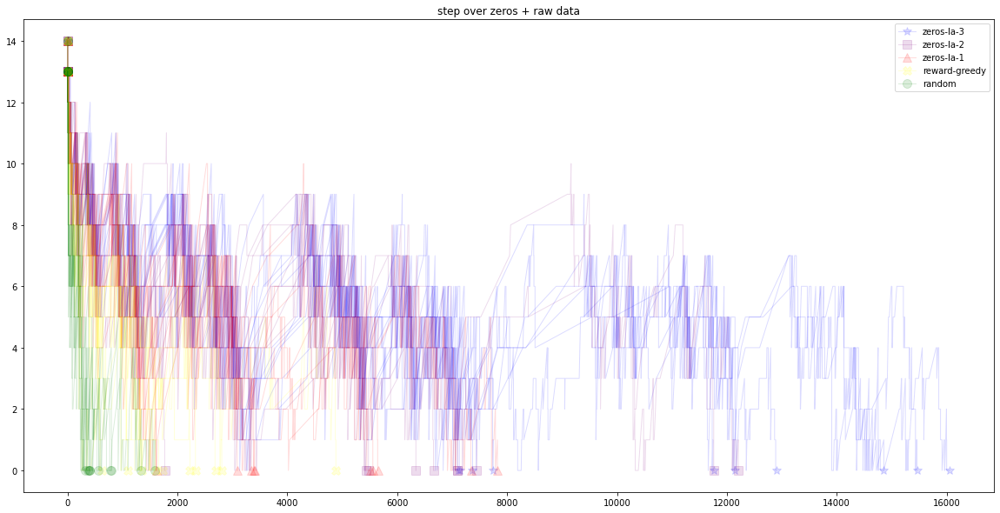

In [3]:
# This is the plotting-function required in ex3, but we define it here so we can
# already visualize it here

MARKERS = dict(zip(ALGO, "oX^s*"))  # circle, cross, triangle, square, start
COLORS = dict(zip(ALGO, ["green", "yellow", "red", "purple", "blue"]))  # circle, cross, triangle, square, start


def plot_lines(xy, label):
    lines = [g[1] for g in df.groupby("line", group_keys=False)]
    plt.figure(figsize=(20, 10))
    alpha = 1 / np.sqrt(len(lines))
    algos = set()
    for line in reversed(lines):
        x,y = xy[line.index].T
        algo = line["algo"].iloc[0]
        marker = MARKERS[algo]
        color = COLORS[algo]
        if algo not in algos:
            algos.add(algo)
        else:
            algo = None
        plt.plot(x, y, marker=marker, markersize=10, markevery=[0,-1], c=color, alpha=alpha, linewidth=1, label=algo)
    plt.legend()
    plt.title(label + " + " + DATA_NAME)
    plt.show()

DATA_NAME = "raw data"
plot_lines(df[["x", "y"]].to_numpy(), "step over zeros")

# Failed visualization: TSNE + PCA + ICA with different data

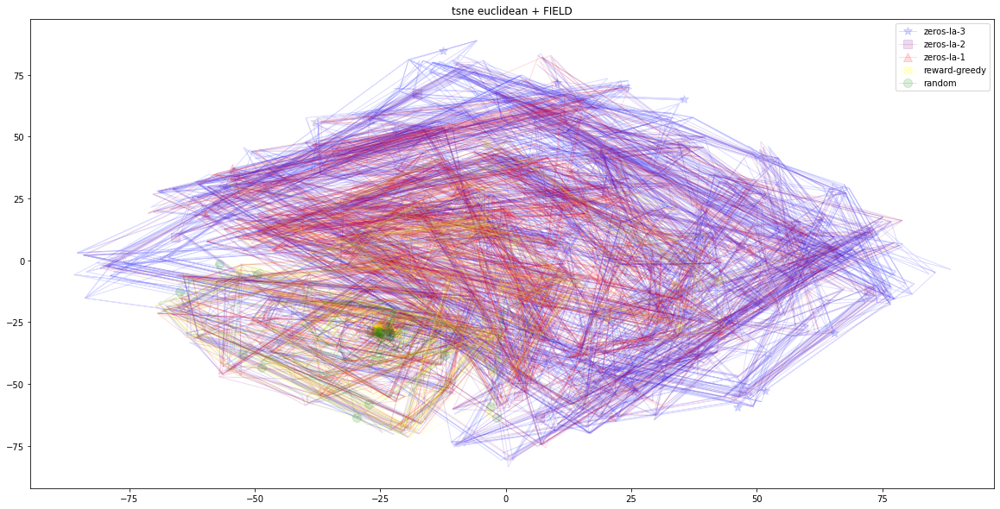

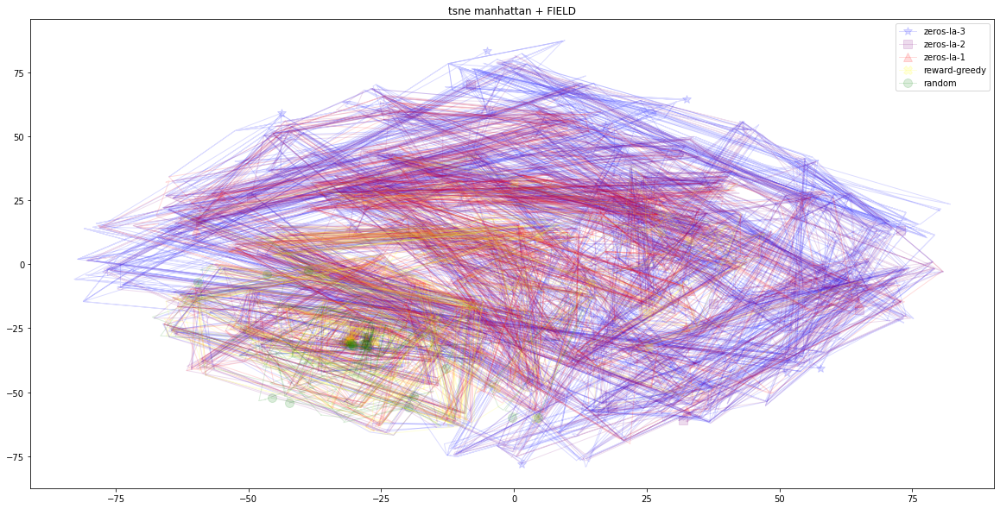

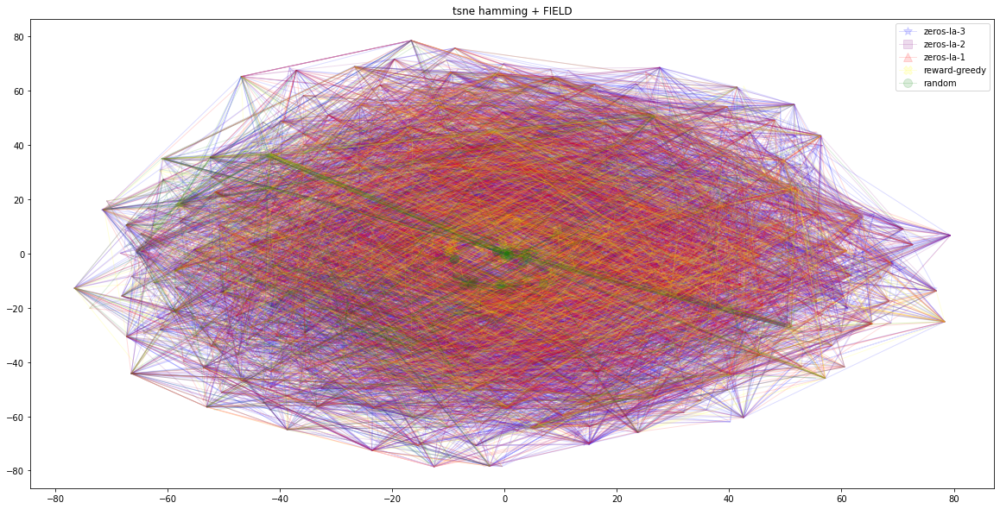

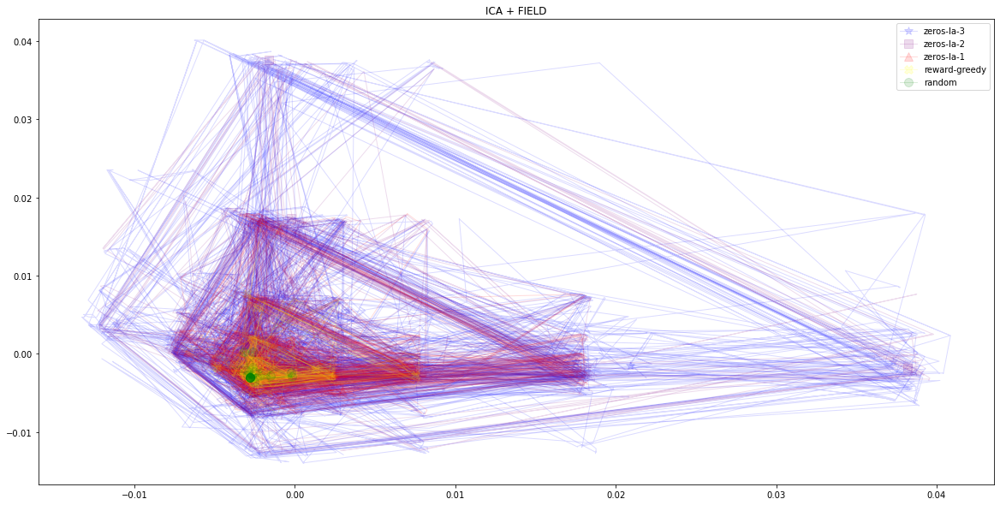

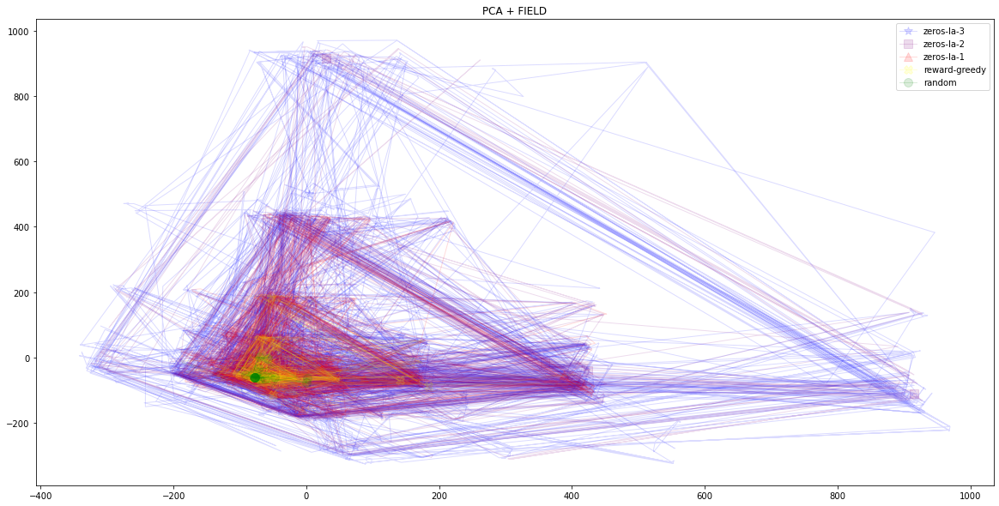

...

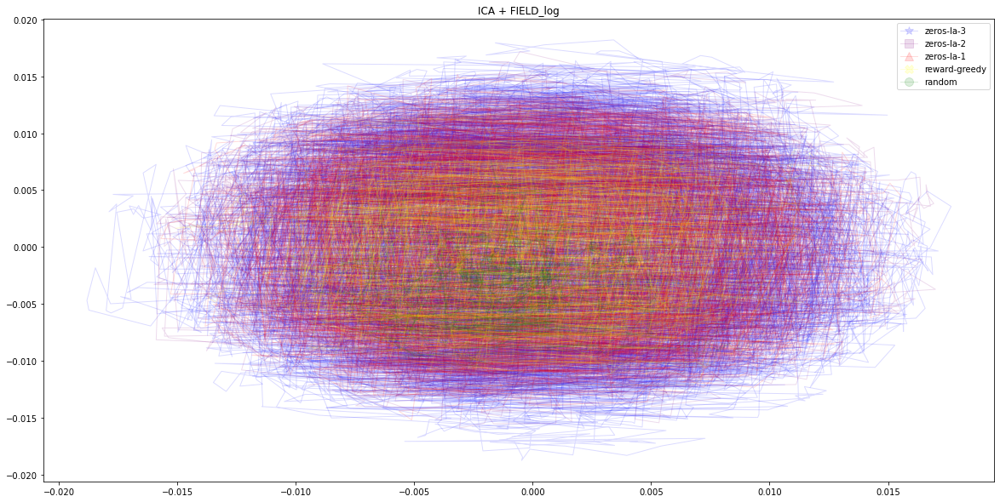

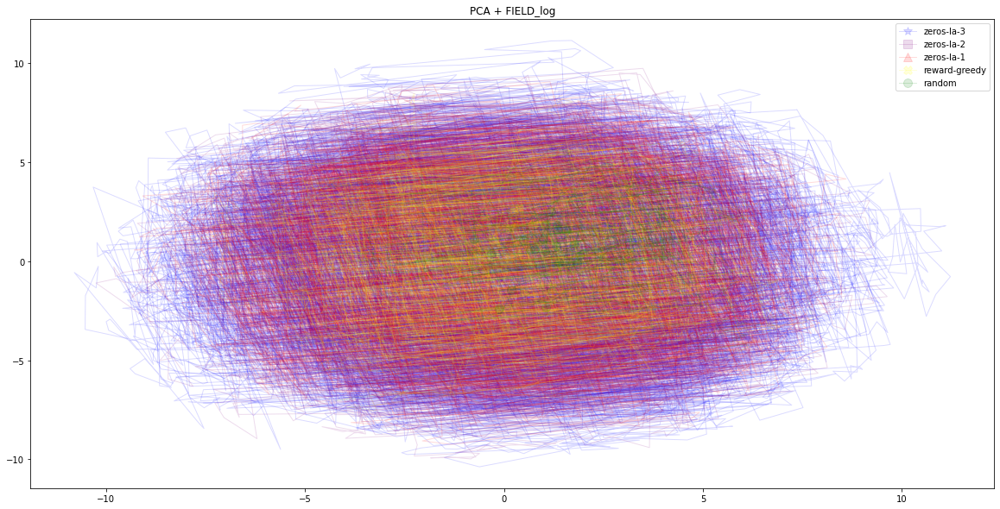

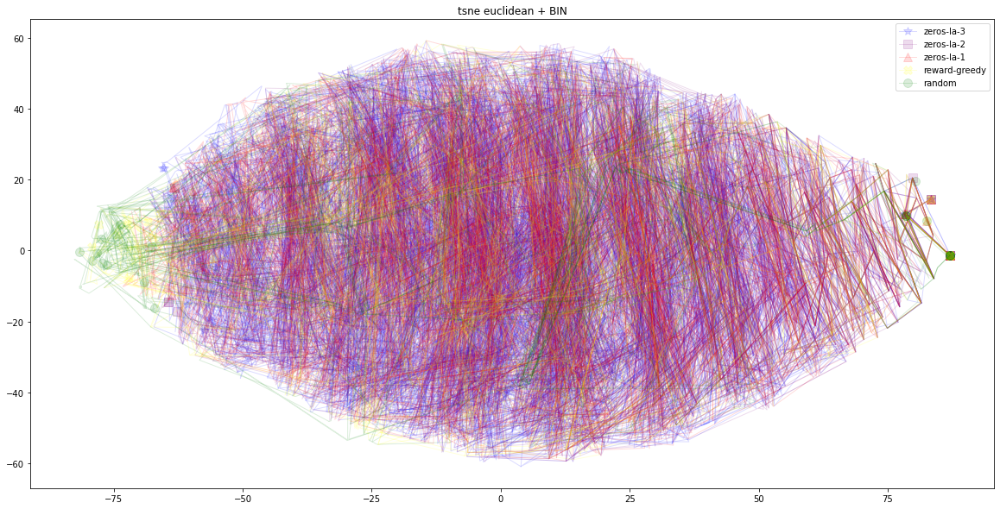

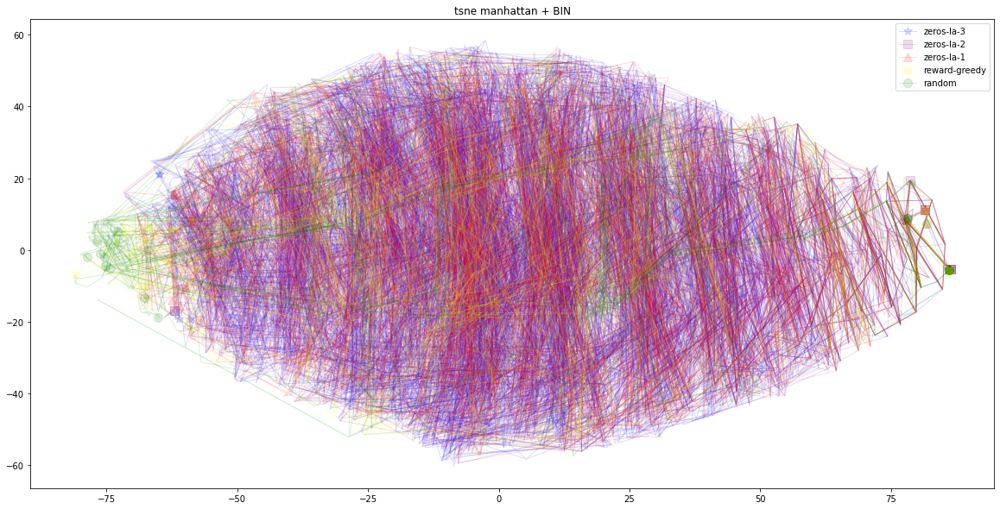

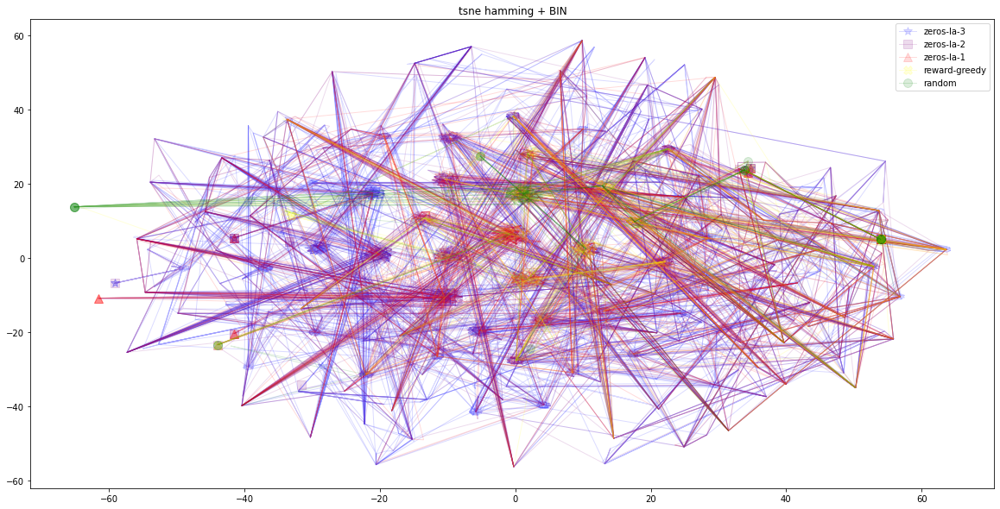

/opt/conda/envs/xai_proj_space/lib/python3.9/site-packages/sklearn/decomposition/_fastica.py:532: RuntimeWarning: divide by zero encountered in true_divide
  K = (u / d).T[:n_components]  # see (6.33) p.140
/opt/conda/envs/xai_proj_space/lib/python3.9/site-packages/sklearn/decomposition/_fastica.py:532: RuntimeWarning: invalid value encountered in true_divide
  K = (u / d).T[:n_components]  # see (6.33) p.140


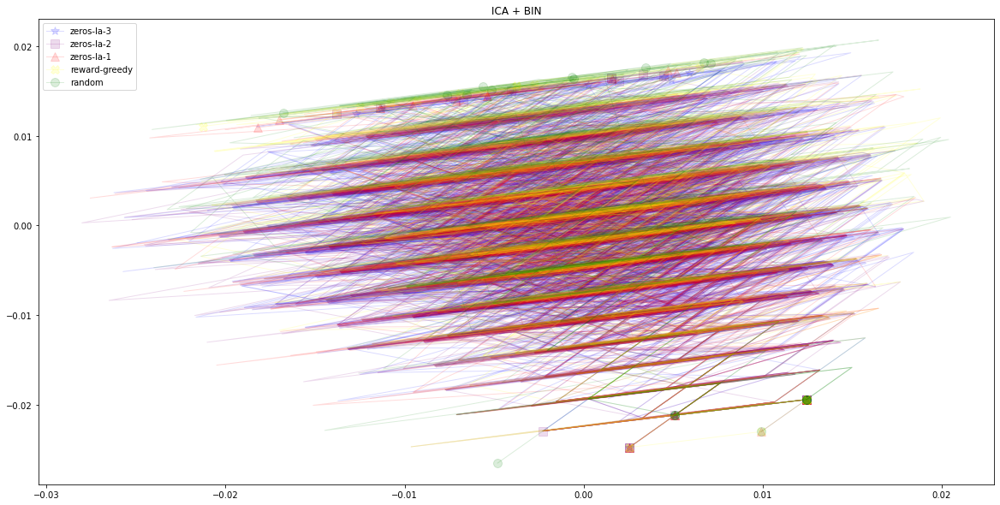

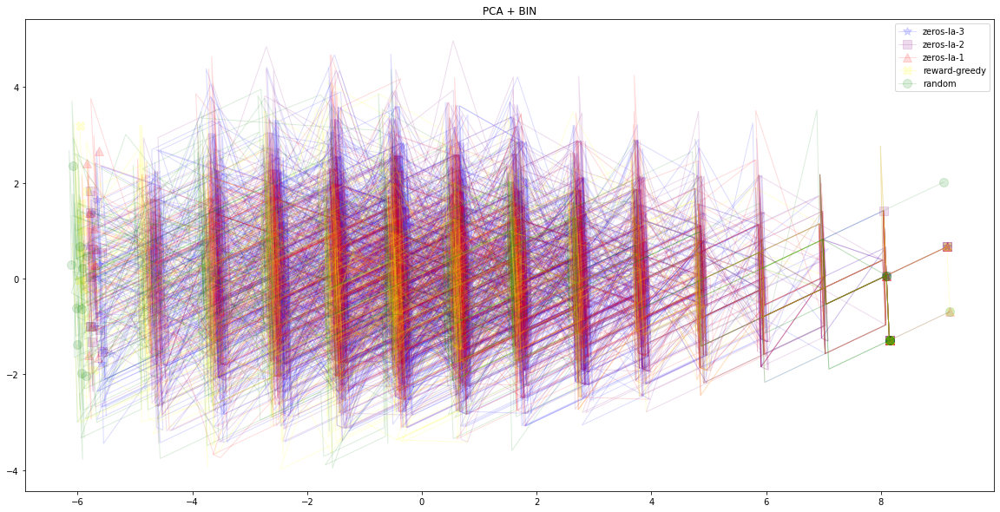

In [4]:
# Rather bad attempts first, including multiple metrics, unfold cell output to see all failed but interesting-looking attempts
TSNE_METRICS = ['euclidean','manhattan','hamming']
UMAP_METRICS = ["euclidean","manhattan","chebyshev","minkowski","canberra","braycurtis","cosine","correlation","hamming","jaccard","dice","kulsinski","ll_dirichlet","hellinger","rogerstanimoto","sokalmichener","sokalsneath","yule"]


df = pd.read_csv(fn)
# try visualizations for fields, log-fields and bins with TSNE, UMAP, PCA and ICA
for DATA_NAME, DATA in (("FIELD", FIELD_), ("FIELD_log", FIELD_), ("BIN", BIN_)):
    xy = df[DATA].to_numpy()
    if DATA_NAME == "FIELD_log":
        xy = np.log2(xy+1)

    for metric in TSNE_METRICS:
        try:
            plot_lines(TSNE(metric=metric).fit(xy), "tsne "+metric)
        except:
            print(metric)
    # for metric in UMAP_METRICS: # didn't yield good resullts so it's commented out
    #     plot_lines(UMAP(metric=metric).fit_transform(xy), "umap "+metric)

    plot_lines(sklearn.decomposition.FastICA(n_components=2).fit_transform(xy), "ICA")

    plot_lines(sklearn.decomposition.PCA(n_components=2).fit_transform(xy), "PCA")

# Better Visualization: 2D-SGD regression - predict step/zeros from state

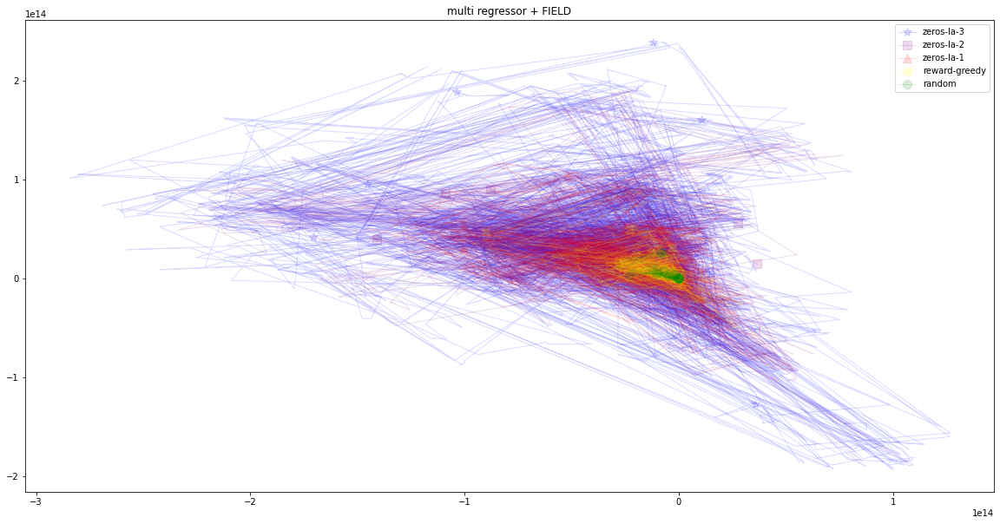

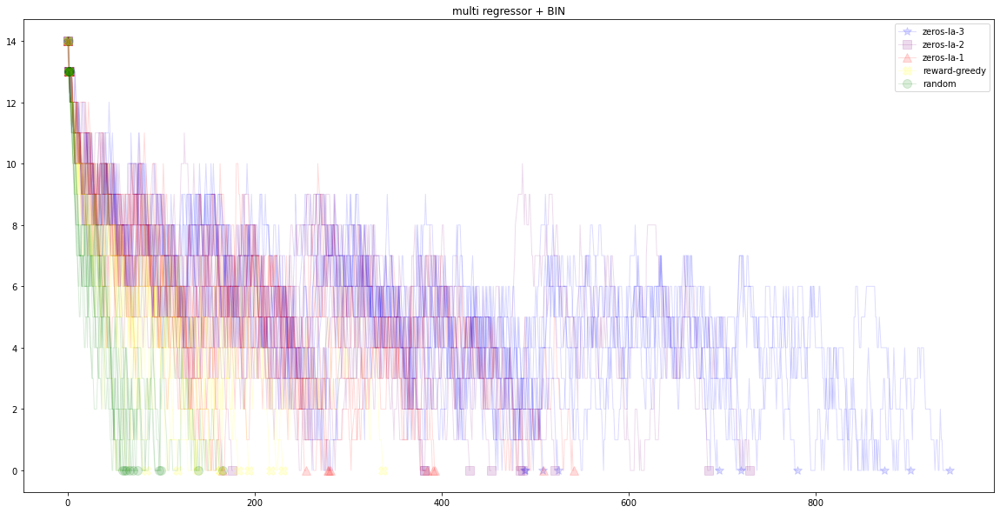

In [5]:
# The better visualization: Multi-Regressor that trys to reconstruct step + zeros from field-values or bins
from sklearn.linear_model import SGDRegressor
from sklearn.multioutput import MultiOutputRegressor

# supervised: fit field or bins to step + zeros +
for DATA_NAME, DATA in (("FIELD", FIELD_), ("BIN", BIN_)):
    xy = df[DATA].to_numpy()

    sgd = MultiOutputRegressor(SGDRegressor())
    sgd.fit(xy, df[["step", "zeros"]]) # "reward", "biggest", "sum"
    xy = sgd.predict(xy)

    plot_lines(xy, "multi regressor")

# Even better visualization: A 3-layer-autoencoder with 2 hidden layers.
# Sadly training a sklearn MLPRegressor is sloooow, so in the next cell, we use torch

LAB = ["step", "zeros", "sum", "biggest"] + FIELD_
xy = df[LAB].to_numpy()

# Best visualization: 5-layer-autoencoder with \*-10-2-10-\* features

**Note**: we did not include pytorch by default. If you want to run this, please install it first.

In [6]:
# Install with CPU computation, see https://pytorch.org/ for CUDA (and change the device parameter below)
# %conda install pytorch torchvision torchaudio cpuonly -c pytorch

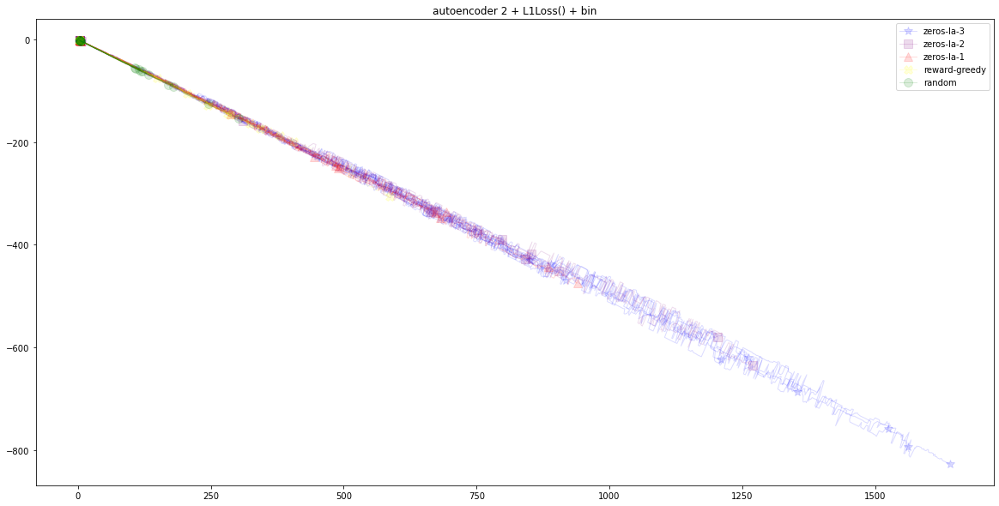

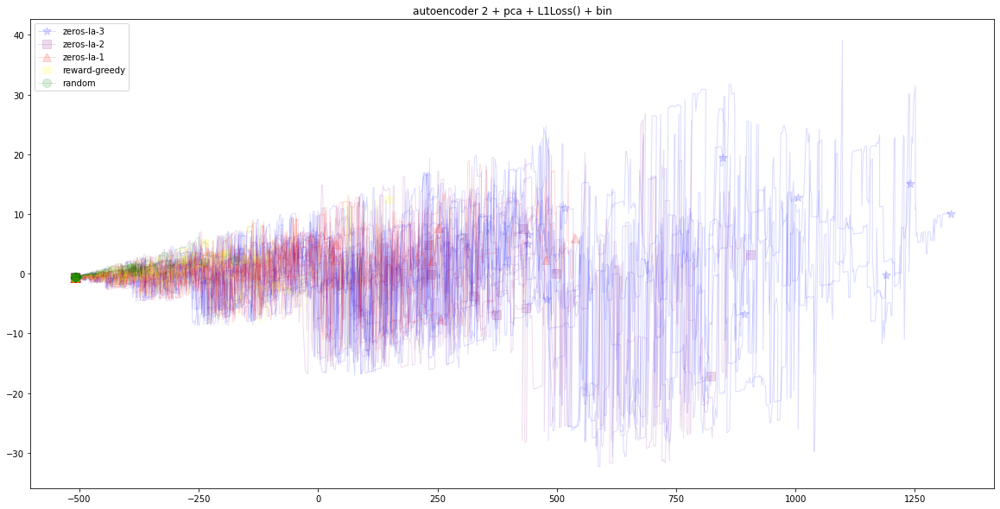

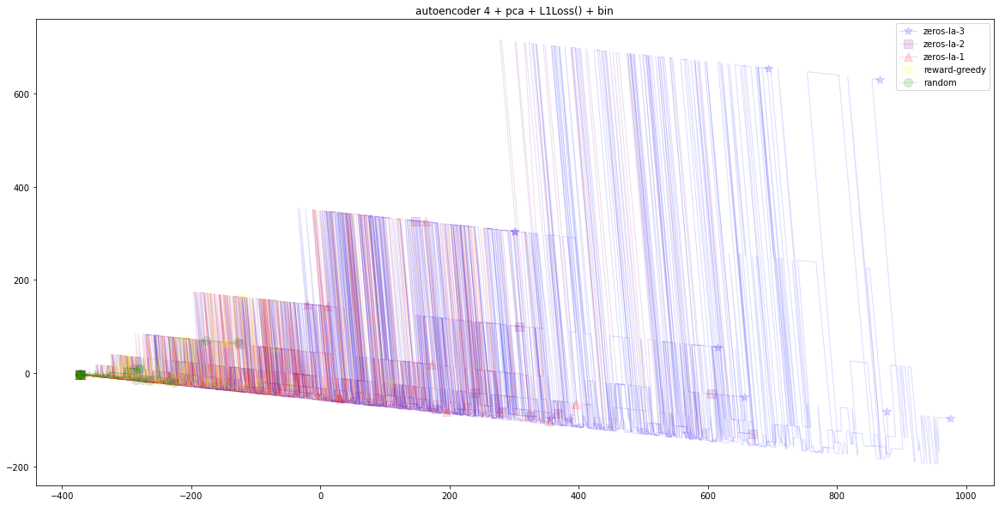

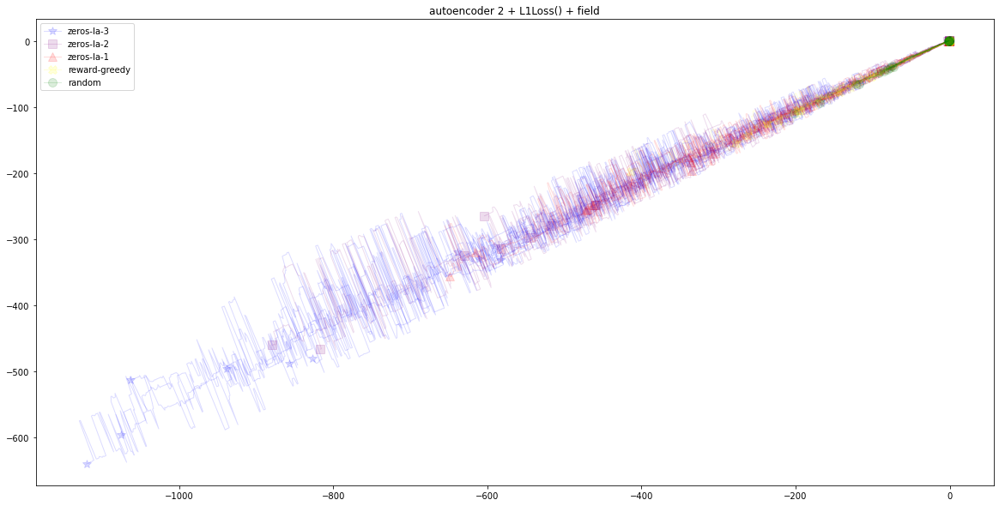

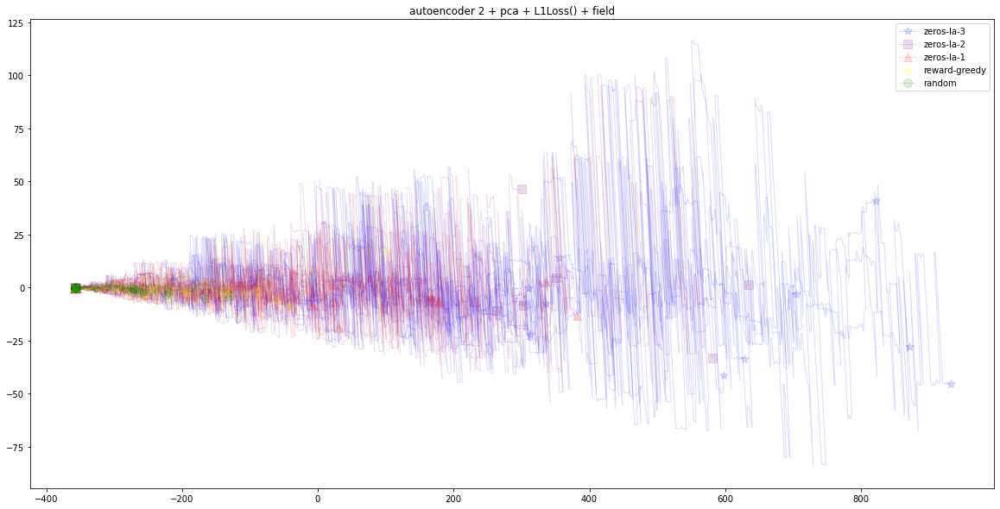

...

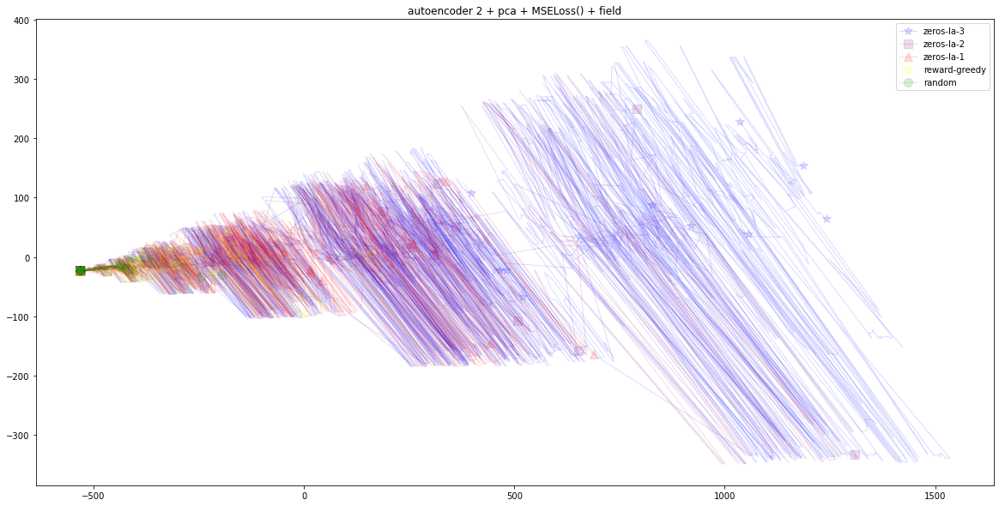

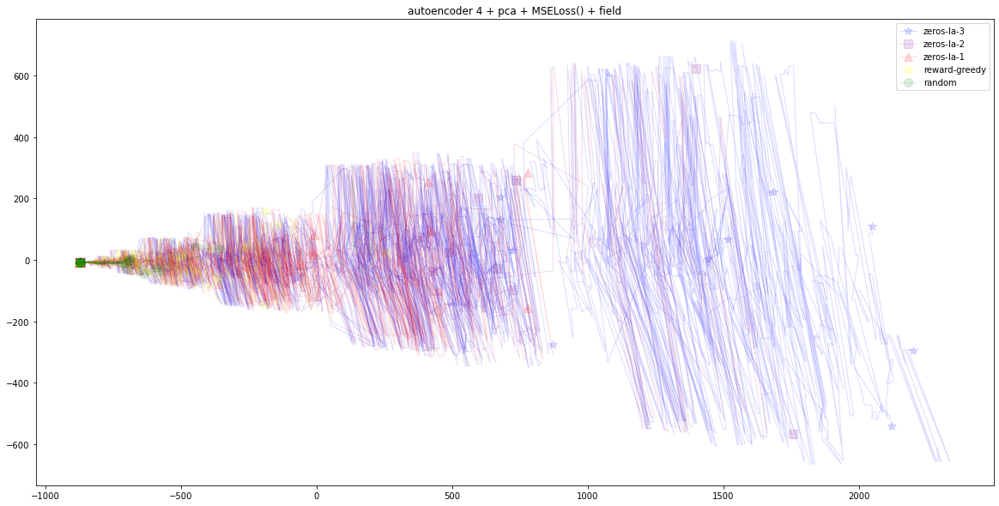

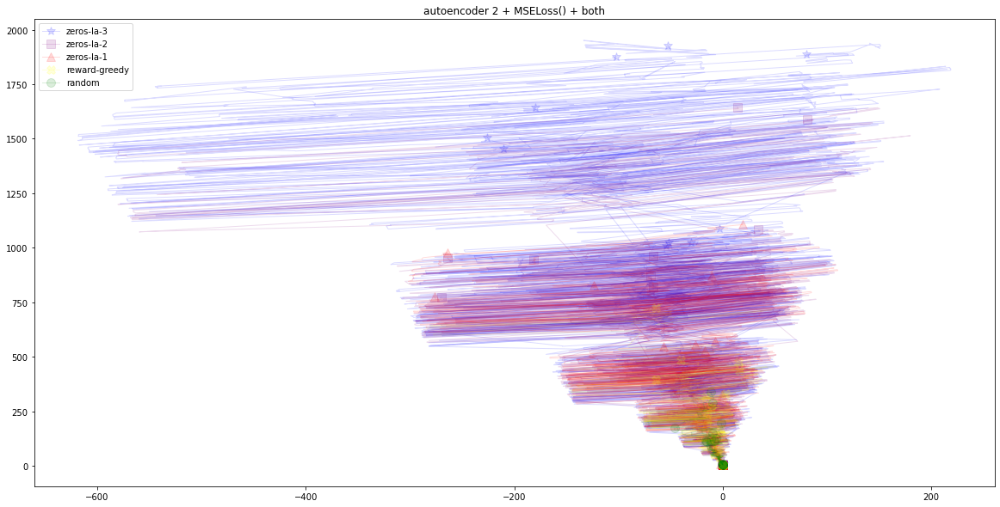

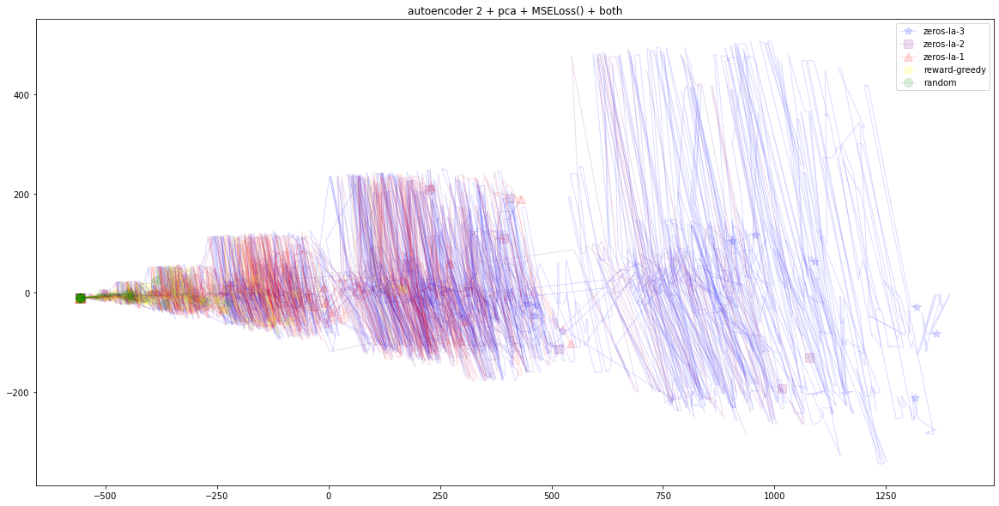

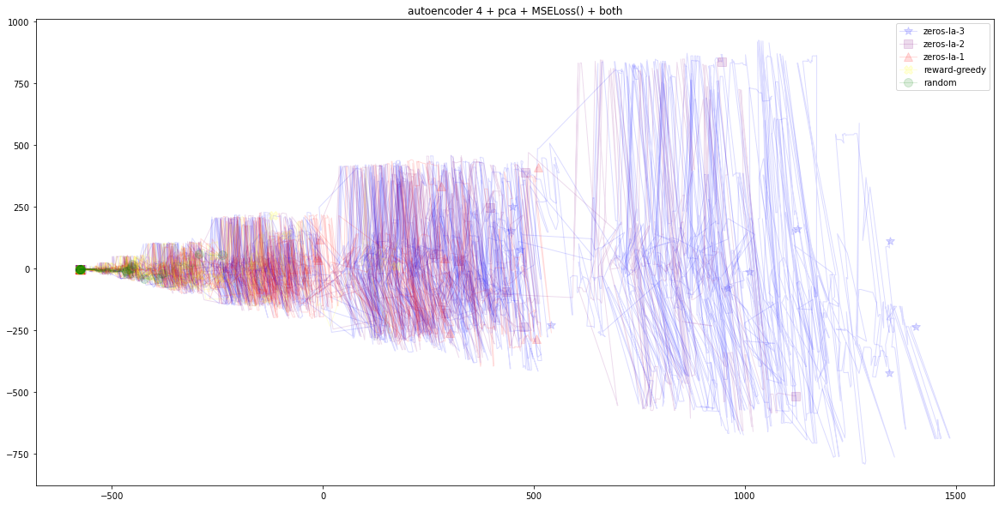

In [7]:

import torch.optim as optim
import torch.nn as nn
import torch
from sklearn.decomposition import PCA


def embed(xy, n_hidden = 20, n_hidden2 = 2, criterion = nn.L1Loss(), batch_size = 2**14, device="cpu", max_iter = 10000,
          lr=0.001, early_stop_tresh=1.001, verbose=True):
    """ Autoencoder with 2 + 1 + 2 layers """
    l0 = nn.Linear(len(xy[0]), n_hidden) # bias=False
    l1 = nn.Linear(n_hidden, n_hidden2) # bias=False
    l2 = nn.Linear(n_hidden2, n_hidden) # bias=False
    l3 = nn.Linear(n_hidden, len(xy[0])) # bias=False

    encoder = nn.Sequential(l0, l1)
    decoder = nn.Sequential(l2, l3)
    net = nn.Sequential(encoder, decoder)

    if verbose:
        print(l0, l1)

    # optimizer = optim.SGD(params=net.parameters(), lr=lr)
    optimizer = optim.Adam(params=net.parameters(), lr=lr)

    # just push all the data + net to GPU once
    inputs = torch.Tensor(xy).to(device)
    net.to(device)

    # modified regular torch training loop: https://pytorch.org/tutorials/beginner/blitz/cifar10_tutorial.html#sphx-glr-beginner-blitz-cifar10-tutorial-py
    running_losses = [1e10]  # start out with a big number, so we don't early stop too early
    for epoch in range(max_iter):  # loop over the dataset multiple times
        running_loss = 0.0
        for i in range(0, len(xy), batch_size):
            # zero the parameter gradients
            optimizer.zero_grad()

            # forward + backward + optimize
            inp = inputs[i:i+batch_size]
            outputs = net(inp)
            loss = criterion(outputs, inp)
            loss.backward()
            optimizer.step()
            running_loss += loss.item()

        running_losses.append(running_loss)

        if not epoch % 100:
            if verbose:
                print(epoch, running_loss)
            best = net.state_dict()
            # early stopping: if the improvement is less than 0.1%
            if max(running_losses[-100:]) <= running_loss * early_stop_tresh:
                if verbose:
                    print("early stopping")
                break

    net.load_state_dict(best)
    return encoder(inputs).to("cpu").detach().numpy()

# Try with different losses + kinds of data
BASE = ["step", "zeros", "sum", "biggest"]
for loss in [nn.L1Loss() , nn.MSELoss()]:
    for DATA_NAME, lab in {"bin": BASE + BIN_, "field": BASE + BIN_, "both": BASE + BIN_ + FIELD_}.items():
        xy = xy = df[LAB].to_numpy()

        embedding_2 = embed(xy, n_hidden=2, verbose=False, criterion=loss)
        plot_lines(embedding_2, f"autoencoder 2 + {loss}")

        embedding_2_pca = PCA(n_components=2).fit_transform(embedding_2)
        plot_lines(embedding_2_pca, f"autoencoder 2 + pca + {loss}")

        embedding_4 = embed(xy, n_hidden=4, verbose=False, criterion=loss)
        embedding_4_pca = PCA(n_components=2).fit_transform(embedding_4)
        plot_lines(embedding_4_pca, f"autoencoder 4 + pca + {loss}")

df[["x", "y"]] = embedding_2_pca
df.to_csv(fn+".autoencoded.csv")

### Comments
- Which features did you use? Why?

I tried different features and combinations in different points, but using any continuous helper (like steps, score, etc.) really helpe, and in general counts seem to be more stable, than fields, because for fields, all values can change in one move.

- Which projection methods did you use? Why?

Most projections like UMAP and TSNE don't work too well for this data, as followup-states are often not too adjacent, especially in the field-space (a-variables)

- Why did you choose these hyperparameters?

Manually experiments with perplexity and n_neighbors but it didn't lead to good results.

For the autoencoder, i experimented with multiple learning rates until the results were good and fast.

- Are there patterns in the global _and_ the local structure?

Yes the global structure shows that the state-space is wider (the more advanced the game is, the more different the field can be) as well as "segments" of the game that coincide with the merging-together of the next-bigger tile.

THe local structure shows that the merging that leads to the next level of field-complexity due to a new highest tile can happen at different times.

### Link States
Connect the states that belong together.

The states of a single solution should be connected to see the path from the start to the end state.
How the points are connected is up to you, for example, with straight lines or splines.

See 2) Projection

### Meta Data Encoding 
Encode addtional features in the visualization.

Use features of the source data and include them in the projection, e.g., by using color, opacity, different shapes or line styles, etc.

See 2) Projection

Added start + end-markers + colors for line-types. Also due to transparency and thin lines and drawing the shorter paths last, you can see more structure.

### Comments
- Which features did you use? Why?
- How are the features encoded?

In the end the autoencoder provided a result very similar to the manually selected features, especially when combined with PCA.
The PCA of the raw data is kind of similar, so the sturcture of the data seems mostly conserved, and the result even without autoencoding looks good after rescaling.

The features are encoded to minimize the reconstruction-loss. Setting a quadratic loss means the algorithm tries to avoid high losses more, so features with a bigger range (score/step) seem to have a bigger impact than reconstructing the counters or a-states.

Rescaling (to log-space or uniform range) didn't make too much of a difference.

## Optional
<details>
    <summary><a>Projection Space Explorer (click to reveal)</a></summary>

    
<h2>Projection Space Explorer</h2>

The <a href="https://jku-vds-lab.at/pse/">Projection Space Explorer</a> is a web application to plot and connect two dimensional points. 
Metadata of the data points can be used to encode additonal information into the projection, e.g., by using different shapes or colors.
    
Further Information:
<ul>
    <li>Paper: <a href="https://jku-vds-lab.at/publications/2020_tiis_pathexplorer/">https://jku-vds-lab.at/publications/2020_tiis_pathexplorer/</a>
    <li>Repo: <a href="https://github.com/jku-vds-lab/projection-space-explorer/">https://github.com/jku-vds-lab/projection-space-explorer/</a>
    <li>Application Overview: <a href="https://jku-vds-lab.at/pse/">https://jku-vds-lab.at/pse/</a>
</ul>

<h3>Data Format</h3>
How to format the data can be found in the <a href="https://github.com/jku-vds-lab/projection-space-explorer/#data-format">Projection Space Explorer's README</a>.

Example data with three lines, with two colors (algo) and additional mark encoding (cp):

<table>
<thead>
  <tr>
    <th>x</th>
    <th>y</th>
    <th>line</th>
    <th>cp</th>
    <th>algo</th>
  </tr>
</thead>
<tbody>
  <tr>
    <td>0.0</td>
    <td>0</td>
    <td>0</td>
    <td>start</td>
    <td>1</td>
  </tr>
  <tr>
    <td>2.0</td>
    <td>1</td>
    <td>0</td>
    <td>state</td>
    <td>1</td>
  </tr>
  <tr>
    <td>4.0</td>
    <td>4</td>
    <td>0</td>
    <td>state</td>
    <td>1</td>
  </tr>
  <tr>
    <td>6.0</td>
    <td>1</td>
    <td>0</td>
    <td>state</td>
    <td>1</td>
  </tr>
  <tr>
    <td>8.0</td>
    <td>0</td>
    <td>0</td>
    <td>state</td>
    <td>1</td>
  </tr>
  <tr>
    <td>12.0</td>
    <td>0</td>
    <td>0</td>
    <td>end</td>
    <td>1</td>
  </tr>
  <tr>
    <td>-1.0</td>
    <td>10</td>
    <td>1</td>
    <td>start</td>
    <td>2</td>
  </tr>
  <tr>
    <td>0.5</td>
    <td>5</td>
    <td>1</td>
    <td>state</td>
    <td>2</td>
  </tr>
  <tr>
    <td>2.0</td>
    <td>3</td>
    <td>1</td>
    <td>state</td>
    <td>2</td>
  </tr>
  <tr>
    <td>3.5</td>
    <td>0</td>
    <td>1</td>
    <td>state</td>
    <td>2</td>
  </tr>
  <tr>
    <td>5.0</td>
    <td>3</td>
    <td>1</td>
    <td>state</td>
    <td>2</td>
  </tr>
  <tr>
    <td>6.5</td>
    <td>5</td>
    <td>1</td>
    <td>state</td>
    <td>2</td>
  </tr>
  <tr>
    <td>8.0</td>
    <td>10</td>
    <td>1</td>
    <td>end</td>
    <td>2</td>
  </tr>
  <tr>
    <td>3.0</td>
    <td>6</td>
    <td>2</td>
    <td>start</td>
    <td>2</td>
  </tr>
  <tr>
    <td>2.0</td>
    <td>7</td>
    <td>2</td>
    <td>end</td>
    <td>2</td>
  </tr>
</tbody>
</table>



Save the dataset to CSV, e.g. using pandas: <tt>df.to_csv('data_path_explorer.csv', encoding='utf-8', index=False)</tt>  
    and upload it in the Projection Space Explorer by clicking on `OPEN FILE` in the top left corner.
    
ℹ You can also include your high dimensionmal data and use it to adapt the visualization.
    
</details>


## Results
You may add additional screenshots of the Projection Space Explorer.

All graphs + also highlighting the end + coloring according to the biggest tile and we can clearly see our game-segment-theory confirmed.

The data used was the `trace10_4.csv.autoencoded.csv` we just saved in the last step.

![All](2048_all.png)

Only the first 3 algorithms so we can zoom in a bit furhter.

![Random vs greedy vs lookahead 1](2048_random_vs_greedy_vs_la1.png)

### Interpretion
- What can be seen in the projection(s)?

There seem to be events in the graph that open up a completely new state space. The distances between them become longer, meaning that it is probably the appearance of a new biggest tile. This leads to a wider state space, which is what makes the game harder. There are more differing tiles lying around and they can form more tile-placements.

- Was it what you expected? If not what did you expect?

Most of the initial visualizations didn't show a lot, as the state-space is in some ways more complex than something like a chess field or a rubics cube and the state changes more in one move than in chess or rubics cube.

Using more complex features like counts and steps/scores really helped it to get to results i expected. A global visualization where you can see the difference in performance of the differing algorithms, and the "global structure" of the game, that unlocking a bigger tile, kind of behaves like a "new level".

- Can you confirm prior hypotheses from the projection?

I didn't have many prior hypothesis, the data analysis was more exploratory, as the state-space of 2048 isn't as well researched as chess or rubics cube. The major difference is that there is no real "end state" like winning that is clearly indicated rounds before, and there is no typical "end game area" in the state-space of "nearly winning states".

- Did you get any unexpected insights?

The global structure of the game with different state-space-segments was kind of interesting.

## Submission
When you’ve finished working on this assignment please download this notebook as HTML and add it to your repository in addition to the notebook file.